In [64]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import  OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import  silhouette_score

import warnings
#warnings.filterwarnings("ignore", category=DeprecationWarning)
warnings.filterwarnings('ignore')
import plotly.express as px
import plotly.io as pio

In [82]:

april_14 = pd.read_csv('uber-raw-data-apr14.csv')
april_14.head()


,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


In [83]:
april_14.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 564516 entries, 0 to 564515
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   Date/Time  564516 non-null  object 
 1   Lat        564516 non-null  float64
 2   Lon        564516 non-null  float64
 3   Base       564516 non-null  object 
dtypes: float64(2), object(2)
memory usage: 17.2+ MB


In [84]:
may_14 = pd.read_csv('uber-raw-data-may14.csv')
june_14 = pd.read_csv('uber-raw-data-jun14.csv')
july_14 = pd.read_csv('uber-raw-data-jul14.csv')
august_14 = pd.read_csv('uber-raw-data-aug14.csv')
september_14 = pd.read_csv('uber-raw-data-sep14.csv')
df = pd.concat([april_14,may_14,june_14,july_14,august_14,september_14], axis=0)
display(df.head())
print(df.shape)

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


(4534327, 4)


In [85]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4534327 entries, 0 to 1028135
Data columns (total 4 columns):
 #   Column     Dtype  
---  ------     -----  
 0   Date/Time  object 
 1   Lat        float64
 2   Lon        float64
 3   Base       object 
dtypes: float64(2), object(2)
memory usage: 173.0+ MB


In [86]:
df.isnull().sum()

Date/Time    0
Lat          0
Lon          0
Base         0
dtype: int64

In [87]:
#to datetime

df['Date/Time'] = pd.to_datetime(df['Date/Time'])

#get new columns with month, hour and day of the week

df['hour'] = df['Date/Time'].dt.hour
df['weekday'] = df['Date/Time'].dt.dayofweek
df['month'] = df['Date/Time'].dt.month
display(df)



,Date/Time,Lat,Lon,Base,hour,weekday,month
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,0,1,4
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,0,1,4
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,0,1,4
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,0,1,4
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,0,1,4
...,...,...,...,...,...,...,...
1028131,2014-09-30 22:57:00,40.7668,-73.9845,B02764,22,1,9
1028132,2014-09-30 22:57:00,40.6911,-74.1773,B02764,22,1,9
1028133,2014-09-30 22:58:00,40.8519,-73.9319,B02764,22,1,9
1028134,2014-09-30 22:58:00,40.7081,-74.0066,B02764,22,1,9


In [88]:
april_14['Date/Time'] = pd.to_datetime(april_14['Date/Time'])

# Obtener nuevas columnas con la hora, el día de la semana y el mes
april_14['hour'] = april_14['Date/Time'].dt.hour
april_14['weekday'] = april_14['Date/Time'].dt.dayofweek
april_14['month'] = april_14['Date/Time'].dt.month

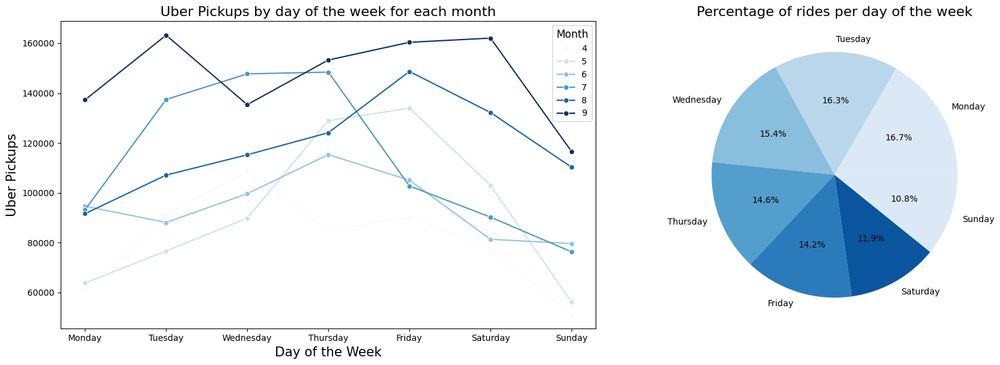

In [89]:
# Realizar la operación groupby para contar la cantidad de viajes por mes y día de la semana
monthly_ride_data = df.groupby(['month', 'weekday']).size().reset_index(name='RideCount')

# Calcular el total de viajes por día de la semana en todo el conjunto de datos
total_rides_per_day = df['weekday'].value_counts()

# Crear la figura con dos subplots en la misma fila
fig, axes = plt.subplots(1, 2, figsize=(18, 6))

# Gráfico de líneas
sns.lineplot(x='weekday', y='RideCount', hue='month', data=monthly_ride_data, palette='Blues', marker='o', ax=axes[0])
axes[0].set_xlabel('Day of the Week', fontsize=15)
axes[0].set_ylabel('Uber Pickups', fontsize=15)
axes[0].set_title('Uber Pickups by day of the week for each month', fontsize=16)
axes[0].set_xticks([0, 1, 2, 3, 4, 5, 6])
axes[0].set_xticklabels(['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])
axes[0].legend(title="Month", fontsize=10, title_fontsize='12')

# Gráfico de pastel
labels = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
axes[1].pie(total_rides_per_day, labels=labels, autopct='%1.1f%%', colors=sns.color_palette('Blues'))
axes[1].set_title('Percentage of rides per day of the week', fontsize=16)

# Ajustar el diseño
plt.tight_layout()
plt.show()


If we look at the pie chart, we could only say that the number of pickups per day of the week is fairly consistent from Monday to Sunday during the period April-September 2014. However, if we examine the chart on the left, it can be observed that in all months, the number of pickups consistently increases from the beginning towards the middle of the week, peaking between Wednesday and Thursday (except for the month of September)

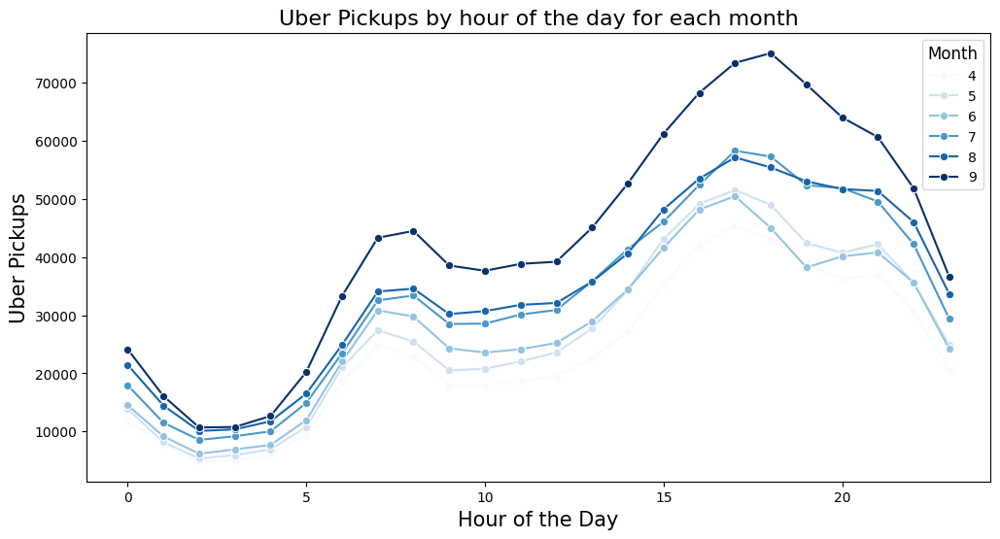

In [90]:
# Perform groupby operation to count the number of rides per month and hour of the day
monthly_ride_data_h = df.groupby(['month', 'hour']).size().reset_index(name='RideCount')

# Create the figure
plt.figure(figsize=(12, 6))

# Create the line plot with one line for each month
sns.lineplot(x='hour', y='RideCount', hue='month', data=monthly_ride_data_h, palette='Blues', marker='o')

# Set titles and axis labels
plt.xlabel('Hour of the Day', fontsize=15)
plt.ylabel('Uber Pickups', fontsize=15)
plt.title('Uber Pickups by hour of the day for each month', fontsize=16)
plt.legend(title="Month", fontsize=10, title_fontsize='12')
plt.show()


This graph shows how orders increase as the hours of the day pass. Every day behaves very similarly, with a first peak at 8 am, then decreasing slightly, and then increasing again to reach its maximum point around 6/7 pm.

In [75]:
#graph
fig = px.histogram(df, x="Base",
                   title='Pickups Per Base',
                   labels={'count':'No of Pickups'},
                   color="weekday",
                   color_discrete_sequence=px.colors.sequential.Blues)
fig.show()

While some bases receive many more orders, the number of orders per day of the week at each base behaves quite regularly

In [ ]:
#PREPROCESSING
# transformers
scaler = StandardScaler()
#encoder = OneHotEncoder(categories='auto', drop='first', sparse_output=False)

column_transformer = ColumnTransformer(
    transformers=[
        ('scaler', scaler, ["Lat", "Lon"])])

# transform
df_preprocessed = column_transformer.fit_transform(df[["Lat", "Lon"]])



In [ ]:
#PREPROCESSING APRIL
# transformers
scaler = StandardScaler()

column_transformer = ColumnTransformer(
    transformers=[
        ('scaler', scaler, ["Lat", "Lon"])])

# transform
april_preprocessed = column_transformer.fit_transform(april_14[["Lat", "Lon"]])

# KMEANS

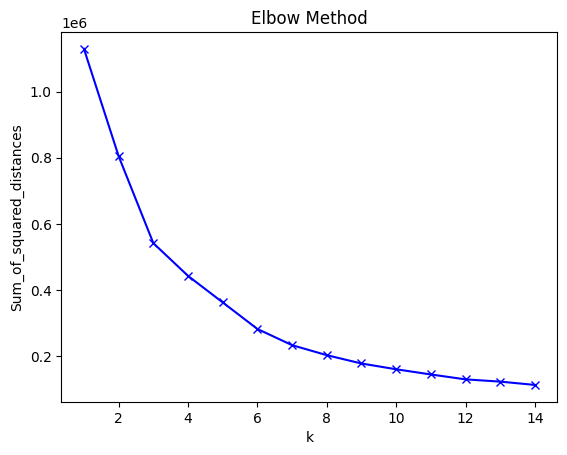

In [91]:
# performing K-Means clustering
K = range(1, 15)
inertia = []

for i in K:
    kmeans = KMeans(n_clusters=i, random_state=0)
    kmeans.fit(april_preprocessed)
    inertia.append(kmeans.inertia_)

# Elbow graph for finding optimal K
plt.plot(K, inertia, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method')
plt.show()

In [79]:
## running K-Means clustering
kmeans=KMeans(n_clusters=9, max_iter = 300, random_state = 0)
kmeans.fit(april_preprocessed)
# Calcular el valor medio de las coordenadas para cada cluster
cluster_cen = kmeans.cluster_centers_

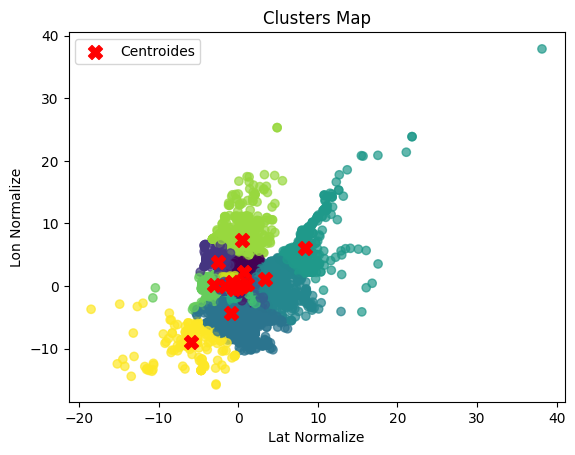

In [92]:
plt.scatter(april_preprocessed[:, 0], april_preprocessed[:, 1], c=kmeans.labels_, cmap='viridis', alpha=0.7)
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], c='red', s=100, marker='X', label='Centroides')
plt.title('Clusters Map')
plt.xlabel('Lat Normalize')
plt.ylabel('Lon Normalize')
plt.legend()
plt.show()

In [81]:
import plotly.express as px

# Asignar clusters a los datos de abril_14
april_14['cluster'] = kmeans.predict(april_preprocessed)

# Crear el gráfico con Plotly Express
fig = px.scatter_mapbox(april_14, lon="Lon", lat="Lat", color="cluster",
                        color_continuous_scale='Portland', zoom=10, height=600)

# Actualizar el estilo de mapbox y el diseño
fig.update_layout(mapbox_style="carto-positron")
fig.update_layout(title_text="Clustering", title_x=0.5)

# Mostrar el gráfico
fig.show()


# DBSCAN

In [ ]:
# Instanciate DBSCAN
db = DBSCAN(eps=0.04, min_samples=100, metric="manhattan",algorithm="ball_tree")

# Fit on data
db.fit(april_preprocessed)

In [ ]:
labels = db.labels_
np.unique(db.labels_)#

In [ ]:
# Create scatter mapbox plot
fig = px.scatter_mapbox(april_14, lon="Lon", lat="Lat", color=labels,
                        color_continuous_scale='Portland', zoom=10, height=600)

# Update mapbox style and layout
fig.update_layout(mapbox_style="carto-positron")

# Show the plot
fig.show()

# Hot Zones Analysis


We are going to use KMeans to analyze the different hot zones by month, day of the week, and time of day

In [49]:
#clustering by month
# month info: 4, 5, 6, 7, 8, 9
def clusterMonth(data, choose_month):
    df_m = data.loc[data['month'] == choose_month, :].copy()
    X = data.loc[data['month'] == choose_month, ['Lat', 'Lon']]

    #pipeline for numeric features
    numeric_features = ['Lat', 'Lon']
    numeric_transformer = StandardScaler()

    #fit transform
    X_scaled = numeric_transformer.fit_transform(X)

    # Model: KMeans
    kmeans = KMeans(n_clusters=8, random_state=42)  #checked before
    clusters = kmeans.fit_predict(X_scaled)

    # add clustering result
    df_m['cluster'] = clusters

    return df_m

In [58]:
#plot by weekday (insert data with cluster info. )
def plot_monthly_clusters(data):
    # graph
    fig = px.scatter_mapbox(data, lon="Lon", lat="Lat", color="cluster",
                            color_continuous_scale='Portland', zoom=10, height=800, width=1000,
                            animation_frame="weekday", animation_group="month",
                            category_orders={"month": [4, 5, 6, 7, 8, 9]})

    # Actualizar el diseño de la figura
    fig.update_layout(mapbox_style="carto-positron")
    fig.update_layout(title=go.layout.Title(text="Clustering by day of the week and month", x=0.5))

    # Agregar evento de clic
    fig.update_traces(marker=dict(size=10), selector=dict(mode='markers'))  # Tamaño de los puntos
    fig.update_layout(clickmode='event+select')  # Modo de clic

    # Mostrar la figura
    return fig.show()



In [59]:
data_may = clusterMonth(df, 5)
plot_monthly_clusters(data_may)

In [60]:
#use cluesterMonth first
def clusterWeekday(data, choose_weekday):
    df_proc = data.loc[data['weekday'] == choose_weekday, :].copy()
    X = data.loc[data['weekday'] == choose_weekday, ['Lat', 'Lon']]

    #create pipeline for numeric features
    numeric_features = ['Lat', 'Lon']
    numeric_transformer = StandardScaler()

    #fit transform
    X_scaled = numeric_transformer.fit_transform(X)

    # Model: KMeans
    kmeans = KMeans(n_clusters=8, random_state=42)
    clusters = kmeans.fit_predict(X_scaled)

    # Add clustering results
    df_proc['cluster'] = clusters

    return df_proc


In [61]:
#plot by hour, choosing weekday
#use clusterweekday function first
def plot_hour_clusters(data):
    # Crear la figura con Plotly Express
    fig = px.scatter_mapbox(data, lon="Lon", lat="Lat", color="cluster",
                            color_continuous_scale='Portland', zoom=10, height=800, width=1000,
                            animation_frame="hour", animation_group="weekday")

    # Actualizar el diseño de la figura
    fig.update_layout(mapbox_style="carto-positron")
    #fig.update_layout(margin={"r": 50, "t": 100, "l": 50, "b": 0})
    fig.update_layout(title=go.layout.Title(text="Clustering by day oth the week and hour", x=0.5))

    # Agregar evento de clic
    fig.update_traces(marker=dict(size=10), selector=dict(mode='markers'))
    fig.update_layout(clickmode='event+select')

    # Mostrar la figura
    return fig.show()



In [62]:
may_processed = clusterWeekday(data_may, 0)  # monday
plot_hour_clusters(may_processed)

In the first plot, we can observe the different clusters formed by grouping them within the same month according to the days of the week, while in the second plot, we see how the clusters move according to the time of day. It is interesting to see how they behave during peak hours (which we observed during the first part of this project to be around 6 or 7 PM)